In this notebook, we aim to sub-cluster the T cells in order to define lv2 and lv3 annotations. We will also test integration with the Chen et al dataset.

In [1]:
# basic python pa \=
import numpy as np
import pandas as pd
import os
import sys 

# plotting
from matplotlib import pyplot as plt 
import seaborn as sns 
import scipy.stats as stats

# singlecell packages
import scanpy as sc
import anndata
import scrublet
import harmonypy as hm

# enrichment analysis 
import gseapy as gp

# other single cell packages
import muon as mu # multi-modal anndatas
import celltypist # automated label predictions
import scirpy # immune cell repertoire analysis
import cellanova as cnova

#sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')

/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# load BigSur
bigsur_dir = '/home/groups/singlecell/smorabito/bin/BigSur/'
sys.path.append(bigsur_dir) 

from BigSur.feature_selection import mcfano_feature_selection as mcfano

In [3]:
# helper func
def append_percent_expressed(adata, marker_genes_df, group_key, expression_thresh):
    """
    Append percentage of cells expressing each gene in the cluster of interest
    (pct_in_group) and in all other clusters (pct_out_group) to the marker gene DataFrame.

    Parameters:
    - adata: AnnData object.
    - marker_genes_df: DataFrame of marker genes generated by sc.tl.rank_genes_groups.
    - group_key: Column in adata.obs containing cluster annotations (e.g., 'leiden').

    Returns:
    - Updated marker gene DataFrame with pct_in_group and pct_out_group columns.
    """
    # Binary matrix indicating whether each gene is expressed in each cell
    binary_matrix = adata.X > expression_thresh  # Adjust if data is log-transformed or sparse
    
    # Initialize new columns
    pct_in_group_list = []
    pct_out_group_list = []

    # Iterate over each cluster in the marker gene DataFrame
    unique_clusters = marker_genes_df["group"].unique()
    for cluster in unique_clusters:
        print(cluster)
        # Create a mask for the cluster of interest
        cluster_mask = adata.obs[group_key] == cluster

        # Calculate percentages
        pct_in_group = np.asarray(binary_matrix[cluster_mask, :].mean(axis=0)).flatten() * 100
        pct_out_group = np.asarray(binary_matrix[~cluster_mask, :].mean(axis=0)).flatten() * 100

        # Map percentages back to marker genes
        for gene in marker_genes_df[marker_genes_df["group"] == cluster]["names"]:
            gene_idx = adata.var_names.get_loc(gene)
            pct_in_group_list.append(pct_in_group[gene_idx])
            pct_out_group_list.append(pct_out_group[gene_idx])

    # Add the calculated percentages to the DataFrame
    marker_genes_df["pct_in_group"] = pct_in_group_list
    marker_genes_df["pct_out_group"] = pct_out_group_list

    return marker_genes_df



In [4]:
# set the project directory 
os.chdir('/home/groups/singlecell/smorabito/analysis/SERPENTINE/')
data_dir = 'data/'
fig_dir = 'figures/'

In [5]:
# re-load
cur_name = 'Tcells'
adata = sc.read_h5ad('{}SERPENTINE_{}_harmony_29-11-24_processed.h5ad'.format(data_dir, cur_name))

In [4]:
# load the initial annotated object
adata_full = sc.read_h5ad('{}SERPENTINE_PCA_27-11-24_annotated.h5ad'.format(data_dir))

/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


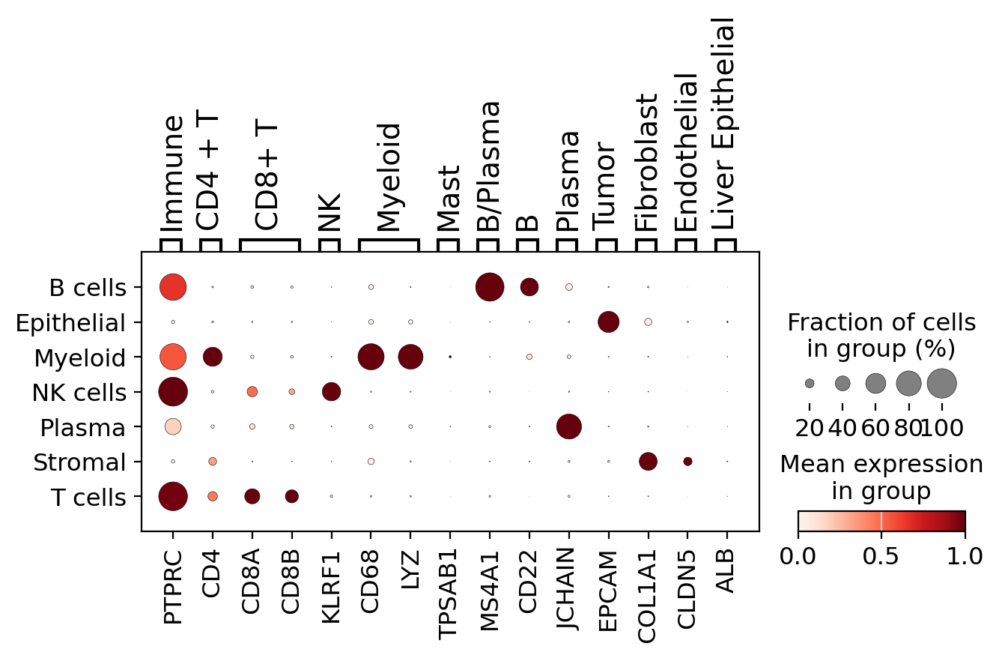

In [9]:

sc.settings.set_figure_params(dpi=100, dpi_save=300, figsize=(15,5), facecolor='white')

marker_dict = {
    'Immune': ['PTPRC'],
    'CD4 + T': ['CD4'],
    'CD8+ T': ['CD8A', 'CD8B'],
    'NK': ['KLRF1'],
    'Myeloid': ['CD68', 'LYZ'],
    'Mast': ['TPSAB1'],
    'B/Plasma': ['MS4A1'],
    'B': ['CD22'],
    'Plasma': ['JCHAIN'],
    'Tumor': ['EPCAM'],
    'Fibroblast': ['COL1A1'],
    'Endothelial': ['CLDN5'],
    'Liver Epithelial': ['ALB']
}


sc.pl.dotplot(
    adata_full, marker_dict, 'cell_type',
    standard_scale='var', swap_axes=False
)

#sc.pl.dotplot(adata, marker_dict, groupby='leiden', figsize=(12,6), standard_scale='var',  dendrogram=True, save='markers.pdf')

## Subset the T-cell and NK compartment, and re-cluster the data

In [10]:
cur_name = 'Tcells'

In [11]:
# subset
adata = adata_full[adata_full.obs.cell_type.isin(['NK cells', 'T cells'])].copy()

In [12]:
# reset the X to the log-normalized counts
adata.X = adata.layers['counts'].copy()

In [13]:
# remove genes with very few counts:
sc.pp.filter_genes(adata, min_cells=3)
adata.shape

(173880, 29837)

In [14]:
# normalize
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [15]:
# run mcfano feature selection
mcfano(adata, layer='counts')

Using 0.05 for pvalue cutoff and 0.9 for mcfano quantile cutoff for highly variable genes.
After fitting, cv = 0.6


In [16]:
sc.tl.pca(adata)

## Integration (Harmony) + clustering

In [17]:
sc.external.pp.harmony_integrate(adata, key = ['Subproject_CNAG'])

2024-11-29 12:25:19,083 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
Computing initial centroids with sklearn.KMeans...
2024-11-29 12:25:53,602 - harmonypy - INFO - sklearn.KMeans initialization complete.
sklearn.KMeans initialization complete.
2024-11-29 12:25:54,842 - harmonypy - INFO - Iteration 1 of 10
Iteration 1 of 10
2024-11-29 12:27:01,830 - harmonypy - INFO - Iteration 2 of 10
Iteration 2 of 10
2024-11-29 12:28:04,344 - harmonypy - INFO - Iteration 3 of 10
Iteration 3 of 10
2024-11-29 12:29:06,500 - harmonypy - INFO - Iteration 4 of 10
Iteration 4 of 10
2024-11-29 12:30:01,013 - harmonypy - INFO - Iteration 5 of 10
Iteration 5 of 10
2024-11-29 12:30:35,751 - harmonypy - INFO - Converged after 5 iterations
Converged after 5 iterations


In [18]:
# neighbors
sc.pp.neighbors(
    adata, use_rep = 'X_pca_harmony', 
    n_neighbors=20, n_pcs=30, metric='cosine'
)

In [19]:
sc.tl.umap(adata, min_dist=0.35, method='umap')

In [20]:
adata.obsm['X_umap_harmony'] = adata.obsm['X_umap'].copy()

In [33]:
# run leiden clustering with multiple resolutions:

res_list = [0.5, 0.75, 1, 1.25, 1.5]

for res in res_list:
    print(res)
    sc.tl.leiden(adata, resolution=res)
    adata.obs["leiden_{}".format(str(res))] = adata.obs.leiden.to_list()


# sc.tl.dendrogram(adata, 'leiden')


0.5
0.75
1


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


1.25
1.5


In [226]:
# save the results
adata.write('{}SERPENTINE_{}_harmony_29-11-24_processed.h5ad'.format(data_dir, cur_name))

## Cluster marker genes

In [ ]:
# list of leiden cluster columns
clusters =[x for x in adata.obs.columns.to_list() if "leiden" in x and x != "leiden"]

for cur_cluster in clusters:

    print(cur_cluster)
    sc.tl.rank_genes_groups(adata, groupby=cur_cluster, method="wilcoxon")

    # get marker genes and add percent expressed
    marker_genes_df = sc.get.rank_genes_groups_df(adata, group=None)
    updated_marker_genes_df = append_percent_expressed(adata, marker_genes_df, group_key, 0.5) 

    # write to output file:
    updated_marker_genes_df.to_csv("{}markers/{}_subcluster_{}_markers.csv".format(data_dir, cur_name, cur_cluster))



leiden_0.5


leiden_0.5


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'MATH': 57 glyphs before
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'K', 'L', 'M', 'N', 'O', 'P', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', 'a', 'c', 'e', 'eight', 'f', 'five', 'four', 'g', 'i', 'l', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'percent', 'period', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'x', 'zero']
Glyph IDs:   [0, 1, 2, 3, 8, 11, 12, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56, 57, 5

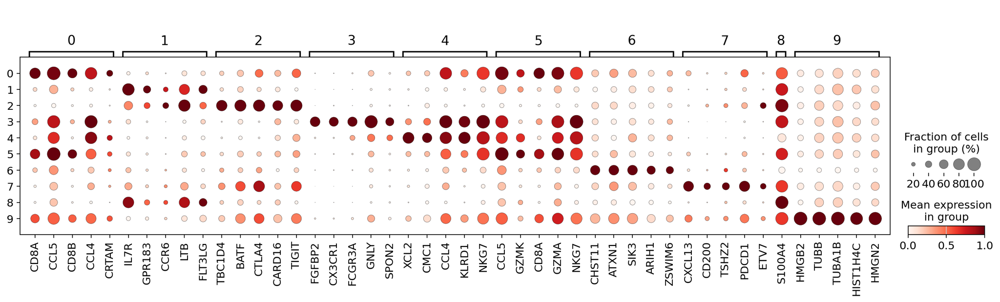

leiden_0.75


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'MATH': 56 glyphs before
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'K', 'L', 'M', 'N', 'O', 'P', 'R', 'S', 'T', 'U', 'X', 'Y', 'Z', 'a', 'c', 'e', 'eight', 'f', 'five', 'four', 'g', 'hyphen', 'i', 'l', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'percent', 'period', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'x', 'zero']
Glyph IDs:   [0, 1, 2, 3, 8, 11, 12, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56, 5

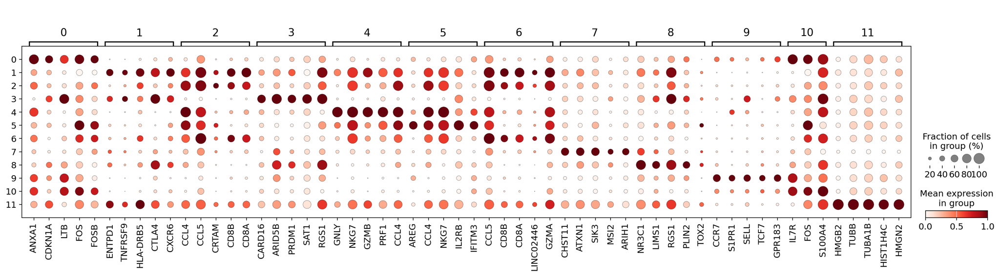

leiden_1


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'MATH': 56 glyphs before
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'K', 'L', 'M', 'N', 'O', 'P', 'R', 'S', 'T', 'U', 'W', 'X', 'Y', 'Z', 'a', 'c', 'e', 'eight', 'f', 'five', 'four', 'g', 'i', 'l', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'percent', 'period', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'x', 'zero']
Glyph IDs:   [0, 1, 2, 3, 8, 11, 12, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56, 58, 59, 60

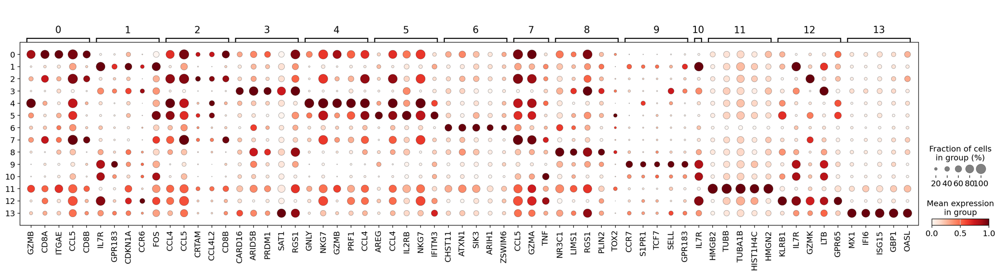

leiden_1.25


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'MATH': 58 glyphs before
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'R', 'S', 'T', 'U', 'V', 'X', 'Y', 'Z', 'a', 'c', 'e', 'eight', 'f', 'five', 'four', 'g', 'hyphen', 'i', 'l', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'percent', 'period', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'x', 'zero']
Glyph IDs:   [0, 1, 2, 3, 8, 11, 12, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 53,

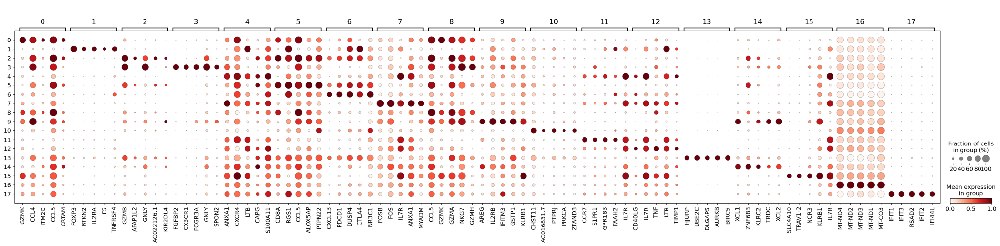

leiden_1.5


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'MATH': 58 glyphs before
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'R', 'S', 'T', 'U', 'V', 'X', 'Y', 'Z', 'a', 'c', 'e', 'eight', 'f', 'five', 'four', 'g', 'hyphen', 'i', 'l', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'percent', 'period', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'x', 'zero']
Glyph IDs:   [0, 1, 2, 3, 8, 11, 12, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 53,

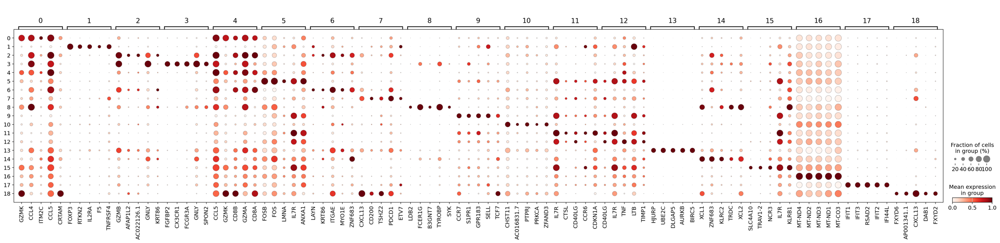

In [222]:
sc.settings.set_figure_params(dpi=100, dpi_save=500, figsize=(5,3), facecolor='white')

#-----------------------------------------------------------#
# make dotplots of the top 5 marker genes per cluster
#-----------------------------------------------------------#

# set the thresholds for plotting
p_thresh = 0.05 
lfc_thresh = 1.0
pct_in_thresh = 25
top_n = 5


for cur_cluster in clusters:

    print(cur_cluster)
    
    # get the full list of marker genes
    markers = pd.read_csv("{}markers/{}_subcluster_{}_markers.csv".format(data_dir, cur_name, cur_cluster))
    markers = markers.drop(markers.columns[0], axis=1)
    markers.group = markers.group.astype(str).astype('category')
    markers.group = markers.group.cat.reorder_categories(adata.obs[cur_cluster].cat.categories.to_list(), ordered=True)
    
    # Subset for p-value, log fold change, and percentage expression thresholds
    filtered_markers = markers[
        (markers["pvals_adj"] < p_thresh) &
        (markers["logfoldchanges"] > lfc_thresh) &
        (markers["pct_in_group"] > pct_in_thresh)
    ]
    
    # Get the top N markers per group
    top_markers = (
        filtered_markers
        .groupby("group")
        .apply(lambda x: x.sort_values(by="logfoldchanges", ascending=False).head(top_n))
    )
    top_markers = top_markers.reset_index(drop=True)

    # calculate marker genes for each of these clusters
    features = top_markers.groupby("group")["names"].apply(list).to_dict()
    
    sc.pl.dotplot(
        adata, features, cur_cluster,
        standard_scale='var', swap_axes=False,
        save = '{}_subcluster_{}_top5markers.pdf'.format(cur_name, cur_cluster.replace('.', ''))
    )


## Testing enrichment analysis with gseapy

https://nbisweden.github.io/workshop-scRNAseq/labs/scanpy/scanpy_05_dge.html

In [173]:
#

# select cluster
cur_group = '0'

# only get significant results
filtered_markers = markers[(markers["pvals_adj"] < 0.05)]

# sort by effect size
cur_markers = filtered_markers[filtered_markers.group == cur_group].sort_values(by=['logfoldchanges'], ascending=False)[['names', 'logfoldchanges']]

# run GSEA for this cluster
cur_res = gp.prerank(rnk=cur_markers, gene_sets='GO_Biological_Process_2021')

cur_res.res2d.head()


,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,cellular response to interferon-gamma (GO:0071...,0.606305,2.362957,0.0,0.001641,0.001,22/60,8.44%,VCAM1;CCL5;CCL4;HLA-DRB5;HLA-DQA2;HLA-DQA1;HLA...
1,prerank,interferon-gamma-mediated signaling pathway (G...,0.599036,2.227771,0.0,0.003283,0.004,26/43,18.21%,VCAM1;HLA-DRB5;HLA-DQA2;HLA-DQA1;HLA-DRA;HLA-D...
2,prerank,microtubule cytoskeleton organization involved...,-0.656411,-1.82586,0.0,0.074606,0.07,38/83,20.87%,SPC25;DLGAP5;AURKB;ESPL1;BIRC5;PLK1;KIF2C;CDC2...
3,prerank,positive regulation of mitotic cell cycle phas...,-0.741285,-1.819026,0.0,0.045641,0.087,10/30,10.35%,ADAMTS1;DLGAP5;ESPL1;UBE2C;CDCA5;PLCB1;CDK1;CD...
4,prerank,regulation of cytokinesis (GO:0032465),-0.710038,-1.805856,0.0,0.047689,0.127,16/38,13.95%,KIF20A;AURKB;E2F8;PLK1;KIF14;SVIL;KIF23;CIT;E2...


In [174]:
# thresholds
p_thresh = 0.05 
lfc_thresh = 1.0
pct_in_thresh = 10

# get the full list of marker genes
markers = updated_marker_genes_df.copy()

# Subset for p-value, log fold change, and percentage expression thresholds
filtered_markers = markers[
    (markers["group"] == cur_group) &
    (markers["pvals_adj"] < p_thresh) &
    (markers["logfoldchanges"] > lfc_thresh) &
    (markers["pct_in_group"] > pct_in_thresh)
]

# run enrichr for this cluster:
cur_enr_res = gp.enrichr(
    gene_list=filtered_markers.names.to_list(), 
    organism='Human', 
    gene_sets='GO_Biological_Process_2021', 
    cutoff = 0.5
)
cur_enr_res.results.head()




,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2021,cellular response to interferon-gamma (GO:0071...,13/121,1.139023e-17,7.403649e-15,0,0,55.527132,2166.323070,HLA-DRB5;VCAM1;OASL;IFNG;CCL5;CCL4;HLA-DPB1;HL...
1,GO_Biological_Process_2021,interferon-gamma-mediated signaling pathway (G...,11/68,3.962787e-17,1.287906e-14,0,0,85.285380,3220.972875,HLA-DRB5;VCAM1;IFNG;HLA-DPB1;HLA-DRA;HLA-DQA2;...
2,GO_Biological_Process_2021,regulation of immune response (GO:0050776),13/179,2.056773e-15,4.423585e-13,0,0,36.020454,1218.126669,LAG3;VCAM1;CRTAM;PTPN22;CD200R1;CLEC2B;KLRK1;J...
3,GO_Biological_Process_2021,antigen processing and presentation of exogeno...,11/98,2.722206e-15,4.423585e-13,0,0,55.792337,1871.126229,LAG3;HLA-DRB5;HLA-DMA;HLA-DMB;HLA-DPB1;HLA-DRA...
4,GO_Biological_Process_2021,antigen processing and presentation of peptide...,11/100,3.426790e-15,4.454827e-13,0,0,54.533084,1816.341733,LAG3;HLA-DRB5;HLA-DMA;HLA-DMB;HLA-DPB1;HLA-DRA...


[<Axes: xlabel='Gene Rank', ylabel='Ranked metric'>,
 <Axes: >,
 <Axes: >,
 <Axes: ylabel='Enrichment Score'>]

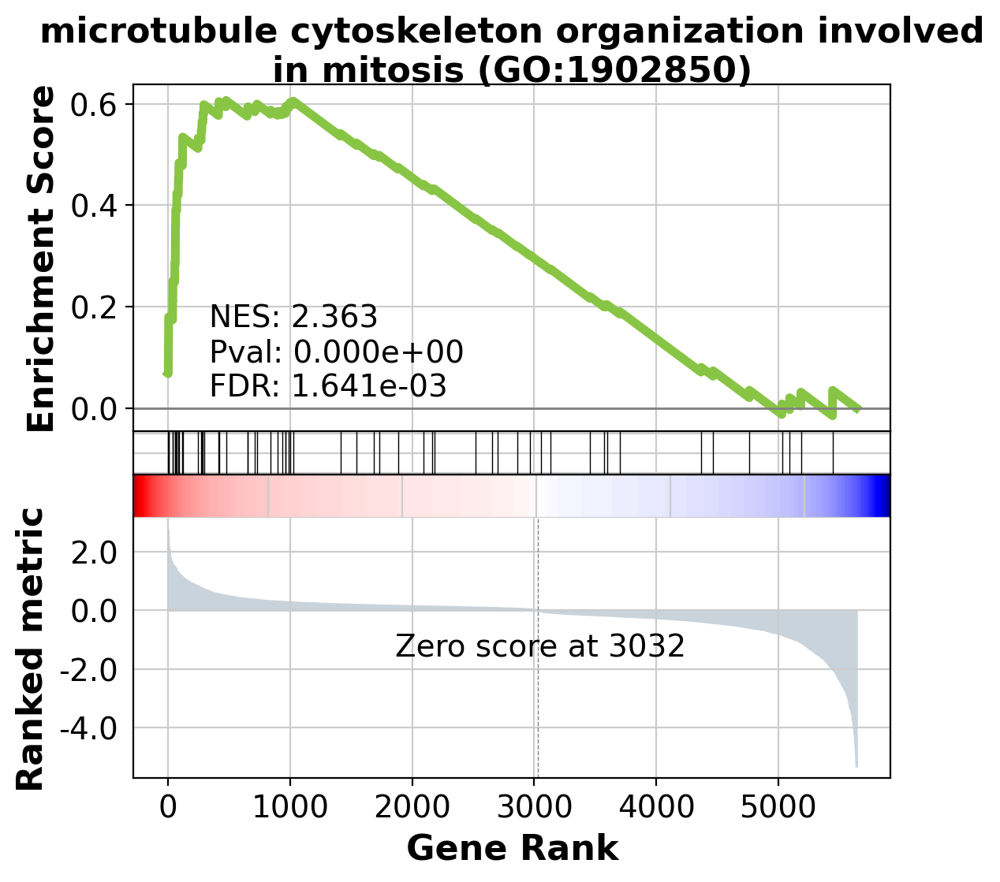

In [175]:
# plot one as an example
gp.gseaplot(rank_metric=cur_res.ranking, term=terms[2], **res.results[terms[0]])


## plotting the clusters

In [40]:
clusters =[x for x in adata.obs.columns.to_list() if "leiden" in x and x != "leiden"]

leiden_0.5


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


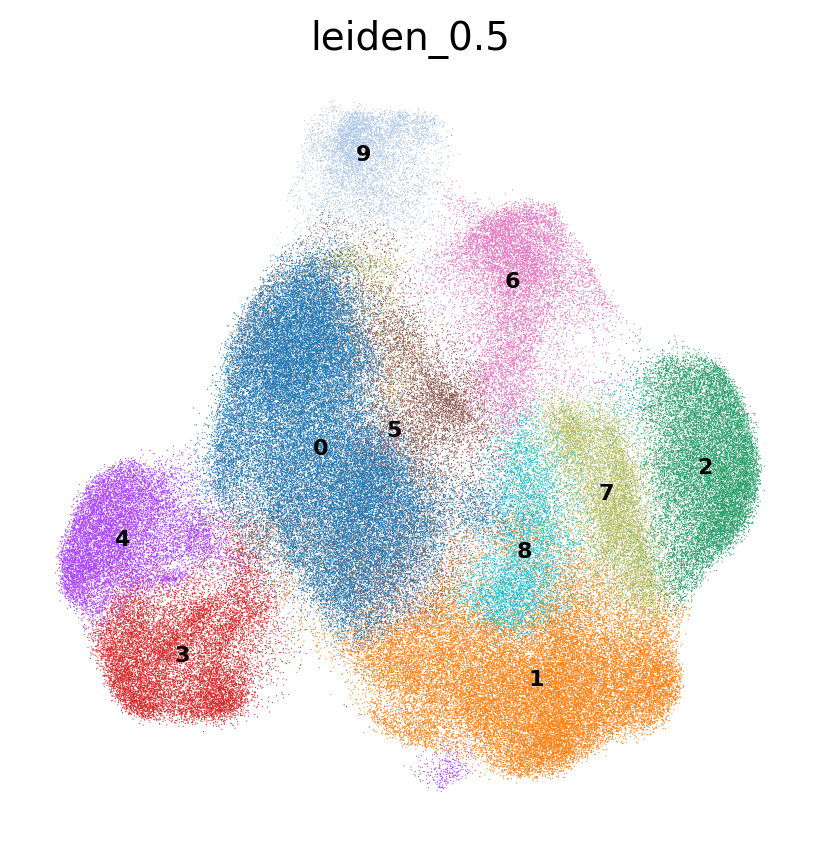

leiden_0.75


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


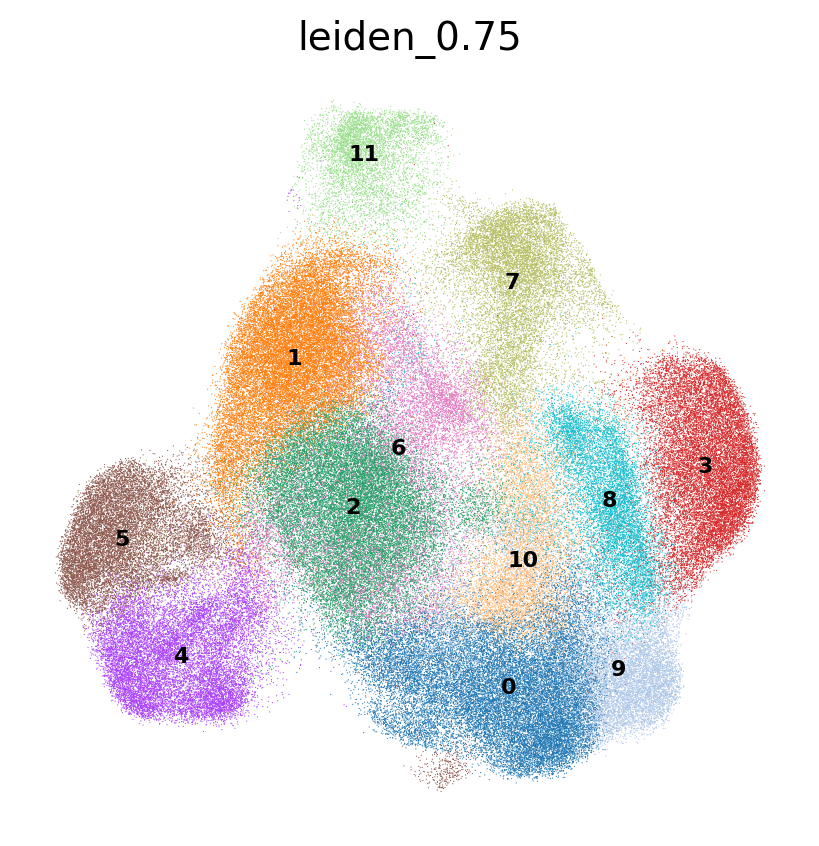

leiden_1


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


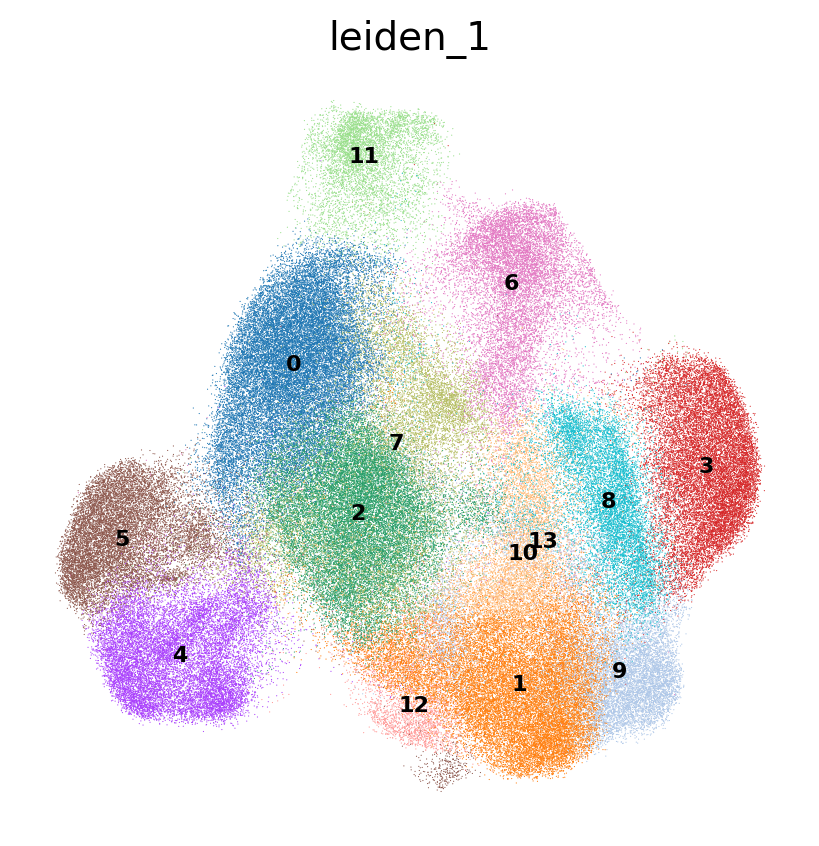

leiden_1.25


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


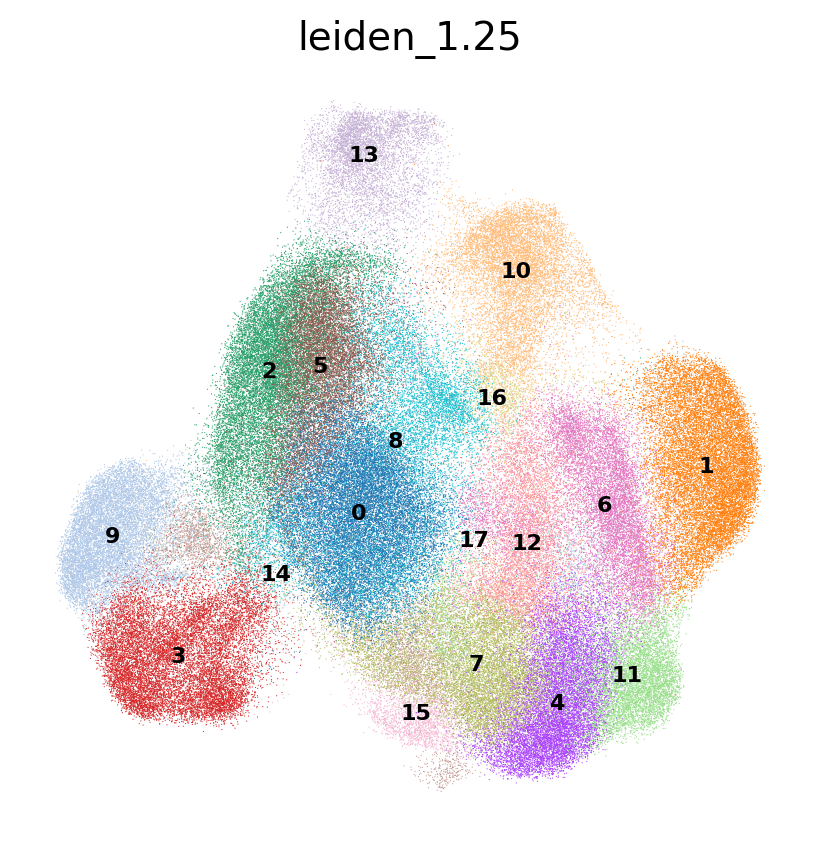

leiden_1.5


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


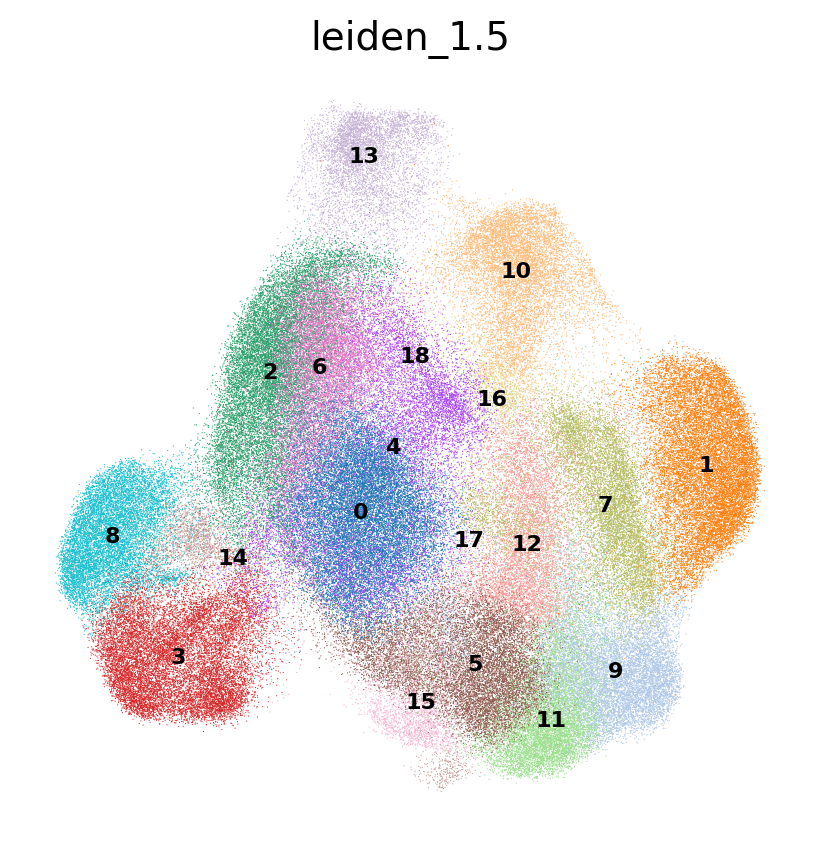

In [64]:
sc.settings.set_figure_params(dpi=100, dpi_save=500, figsize=(5,5), facecolor='white')

for cur_cluster in clusters:
    print(cur_cluster)
    sc.pl.embedding(
        adata,
        basis = 'X_umap_harmony',
        color = cur_cluster,
        legend_loc='on data', 
        legend_fontsize=8, 
        frameon = False,
        save = '_{}_{}.pdf'.format(cur_name, cur_cluster.replace('.', ''))
    )

/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


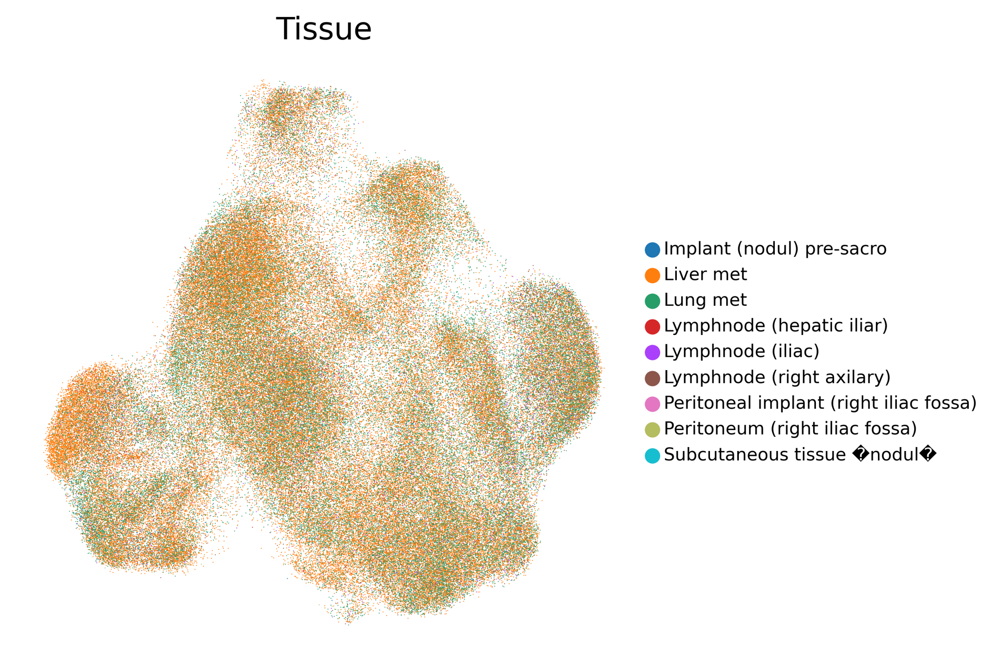

In [23]:
sc.settings.set_figure_params(dpi=200, dpi_save=500, figsize=(5,5), facecolor='white')

sc.pl.embedding(
    adata,
    basis = 'X_umap_harmony',
    color = ["Tissue"],
    legend_fontsize=8, 
    frameon = False,
    save = '_{}_tissue.pdf'.format(cur_name)
)

/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


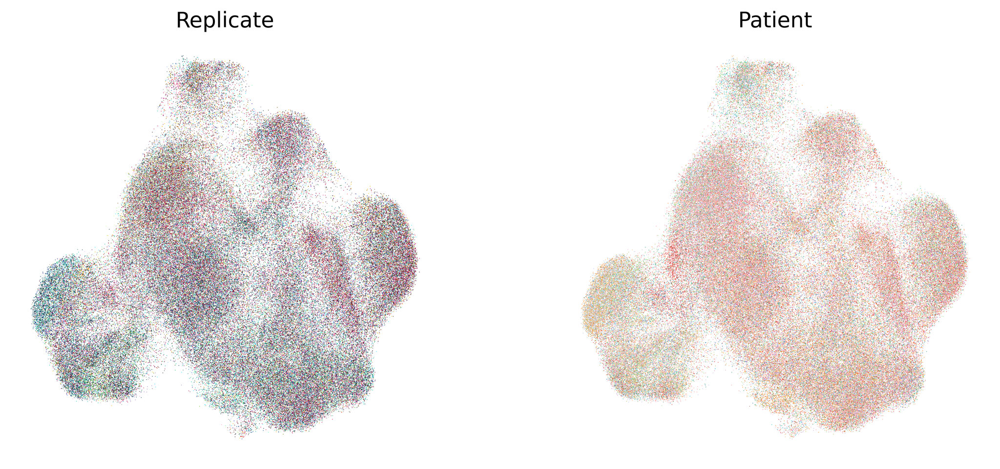

In [24]:
sc.settings.set_figure_params(dpi=300, dpi_save=500, figsize=(5,5), facecolor='white')

sc.pl.embedding(
    adata,
    basis = 'X_umap_harmony',
    color = ["Replicate", "Patient"],
    legend_loc='none', 
    legend_fontsize=8, 
    frameon = False
)

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


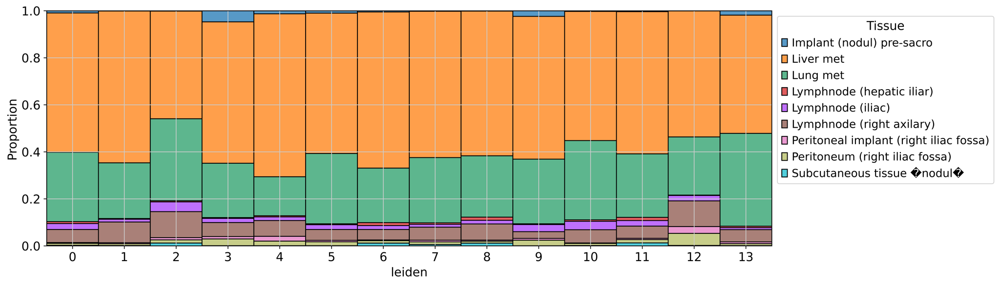

In [61]:
# stacked bar chart
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(15,5), facecolor='white')
ax = sns.histplot(
    data = adata.obs,
    x = 'leiden',
    hue = 'Tissue',
    multiple='fill', stat='proportion',
    discrete=True
)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


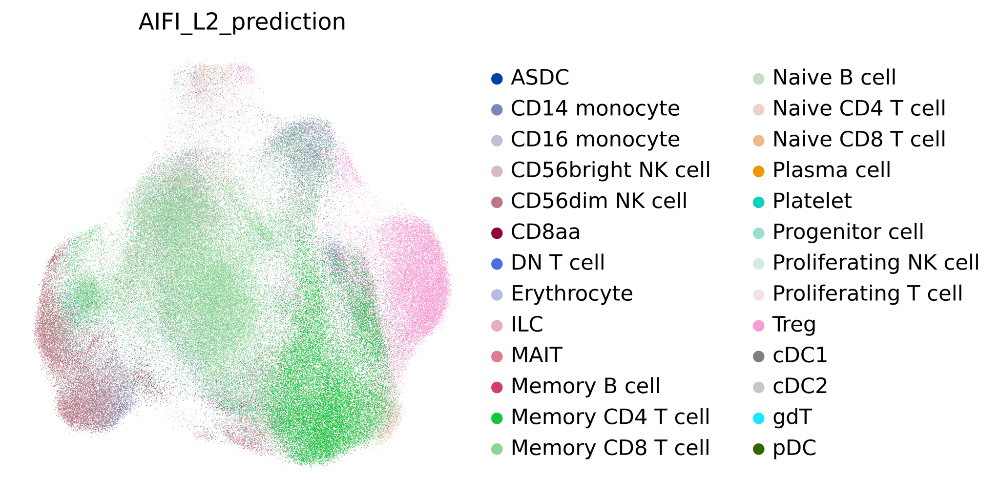

In [63]:
sc.settings.set_figure_params(dpi=300, dpi_save=500, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata,
    color = ['AIFI_L2_prediction'],
    frameon = False
)

In [64]:
adata.obs.AIFI_L2_prediction.value_counts()

AIFI_L2_prediction
Memory CD8 T cell        65323
Memory CD4 T cell        31050
Treg                     25831
CD14 monocyte            16069
CD56dim NK cell          14093
Proliferating T cell      5048
Naive CD4 T cell          3456
MAIT                      3136
Naive B cell              1871
gdT                       1856
Memory B cell             1170
Proliferating NK cell     1105
CD56bright NK cell         804
Naive CD8 T cell           702
CD8aa                      595
Erythrocyte                519
Plasma cell                458
DN T cell                  315
ILC                        176
CD16 monocyte              114
Progenitor cell            102
Platelet                    33
pDC                         27
cDC2                        20
ASDC                         5
cDC1                         2
Name: count, dtype: int64

categories: 0, 1, 2, etc.
var_group_labels: Immune, CD4 + T, CD8+ T, etc.


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


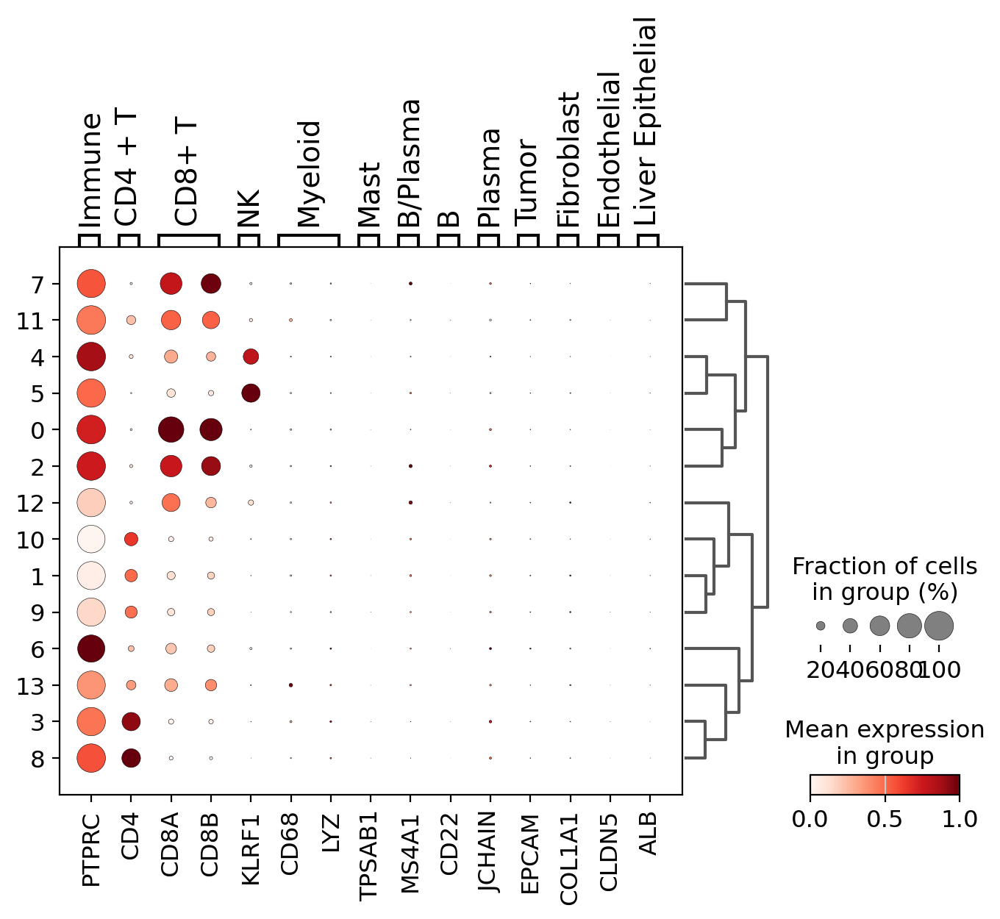

In [31]:

sc.settings.set_figure_params(dpi=100, dpi_save=300, figsize=(15,5), facecolor='white')

marker_dict = {
    'Immune': ['PTPRC'],
    'CD4 + T': ['CD4'],
    'CD8+ T': ['CD8A', 'CD8B'],
    'NK': ['KLRF1'],
    'Myeloid': ['CD68', 'LYZ'],
    'Mast': ['TPSAB1'],
    'B/Plasma': ['MS4A1'],
    'B': ['CD22'],
    'Plasma': ['JCHAIN'],
    'Tumor': ['EPCAM'],
    'Fibroblast': ['COL1A1'],
    'Endothelial': ['CLDN5'],
    'Liver Epithelial': ['ALB']
}


sc.pl.dotplot(
    adata, marker_dict, 'leiden',
    standard_scale='var', swap_axes=False, dendrogram=True
)

#sc.pl.dotplot(adata, marker_dict, groupby='leiden', figsize=(12,6), standard_scale='var',  dendrogram=True, save='markers.pdf')

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

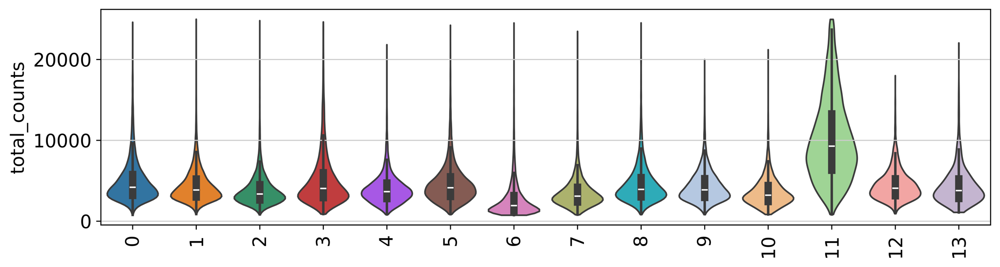

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

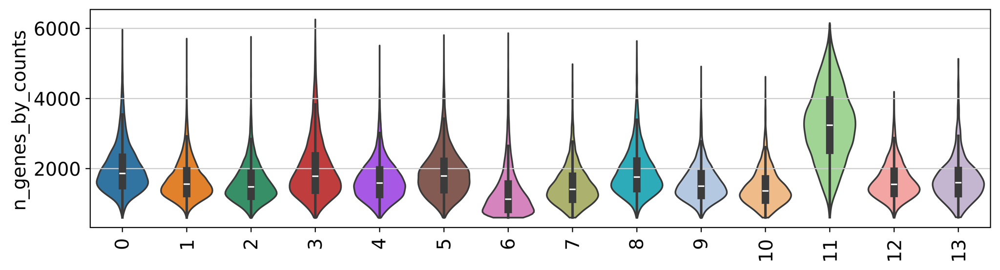

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

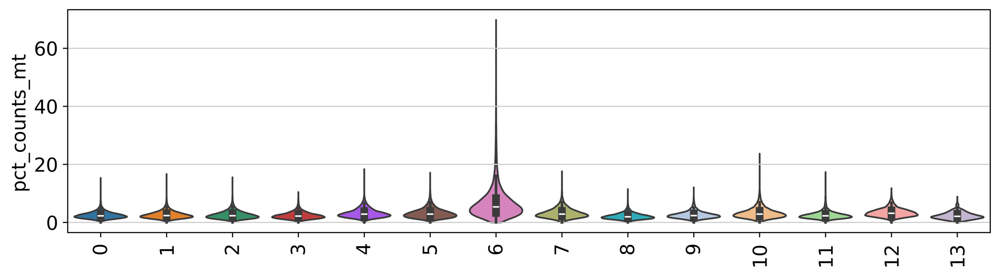

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

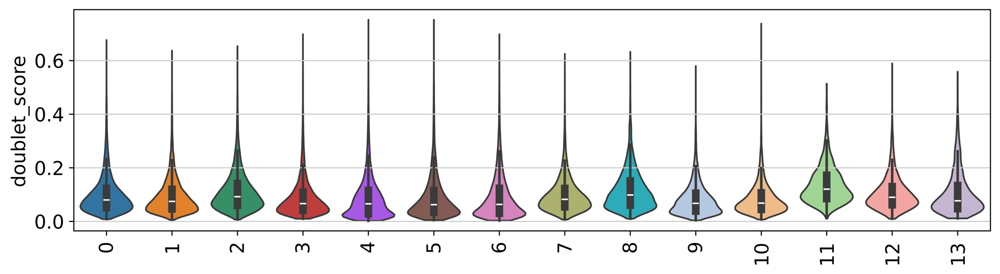

In [32]:
sc.settings.set_figure_params(dpi=400, dpi_save=400, figsize=(10,3), facecolor='white')
sc.pl.violin(adata,[ 'total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=90)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=90)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=90)
sc.pl.violin(adata,[ 'doublet_score'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=90)

## Gerard previous annotations

In [43]:
anno_df = pd.read_table('{}/SP_annotations.csv'.format(data_dir), sep=',')
anno_df = anno_df.rename({'Unnamed: 0': 'barcode'}, axis=1)

anno_df['bc'] = [x.split('_')[-1] for x in anno_df.barcode.to_list()]
anno_df['bc_sample'] = anno_df['sample'].astype(str) + '-' + anno_df.bc.astype(str)

anno_df.head()

,barcode,sample,Annotation_1.0,Annotation_2.0,bc,bc_sample
0,SERPENTINE_04_05_01_CD45_AAACCTGAGCTCAACT,SPE_1_01_SCR_A_FRESH_CD45,Myeloid,cDC2,AAACCTGAGCTCAACT,SPE_1_01_SCR_A_FRESH_CD45-AAACCTGAGCTCAACT
1,SERPENTINE_04_05_01_CD45_AAACCTGAGTGGGATC,SPE_1_01_SCR_A_FRESH_CD45,Myeloid,CD14+ CD16- Mono,AAACCTGAGTGGGATC,SPE_1_01_SCR_A_FRESH_CD45-AAACCTGAGTGGGATC
2,SERPENTINE_04_05_01_CD45_AAACCTGAGTTAAGTG,SPE_1_01_SCR_A_FRESH_CD45,CD8 T,CD8+ Trm Exhausted,AAACCTGAGTTAAGTG,SPE_1_01_SCR_A_FRESH_CD45-AAACCTGAGTTAAGTG
3,SERPENTINE_04_05_01_CD45_AAACCTGTCCGCAGTG,SPE_1_01_SCR_A_FRESH_CD45,CD8 T,T Proliferative,AAACCTGTCCGCAGTG,SPE_1_01_SCR_A_FRESH_CD45-AAACCTGTCCGCAGTG
4,SERPENTINE_04_05_01_CD45_AAACGGGAGCGTTTAC,SPE_1_01_SCR_A_FRESH_CD45,CD4 T,CD4+ T Helper,AAACGGGAGCGTTTAC,SPE_1_01_SCR_A_FRESH_CD45-AAACGGGAGCGTTTAC


In [44]:
adata.obs['bc_sample'] = adata.obs.Replicate.astype(str) + '-' + adata.obs.bc.astype(str)

In [46]:

# merge with anndata obs
temp = adata.obs.merge(anno_df, how='left', on = 'bc_sample')
temp.head()

adata.obs['init_annot_1'] = temp['Annotation_1.0'].to_list()
adata.obs['init_annot_2'] = temp['Annotation_2.0'].to_list()


/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


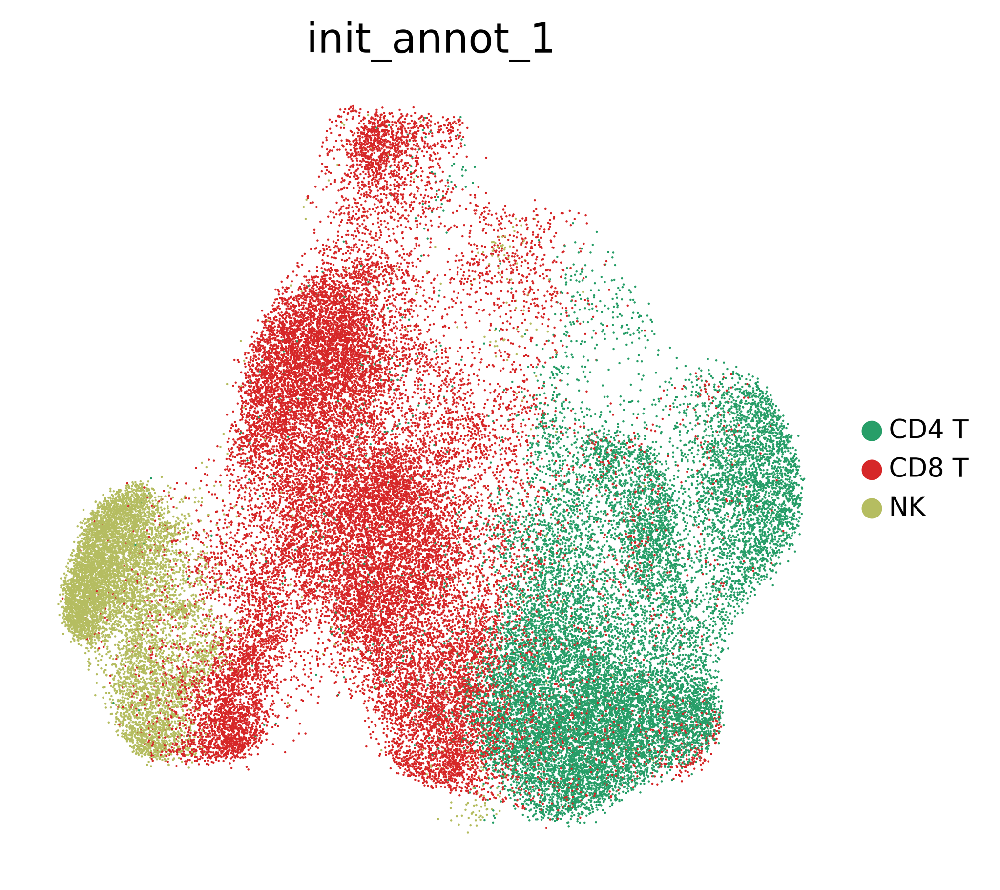

In [59]:
keep = adata.obs.init_annot_1.value_counts().index[adata.obs.init_annot_1.value_counts() >= 300].to_list()

sc.settings.set_figure_params(dpi=300, dpi_save=500, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata[adata.obs.init_annot_1.isin(keep)], 
    color=['init_annot_1'],
    frameon=False, 
    #legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    ncols=1,
    #save='_annot1_previous_QC.pdf'
)

/home/groups/singlecell/smorabito/.conda/envs/scanpy-081124/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


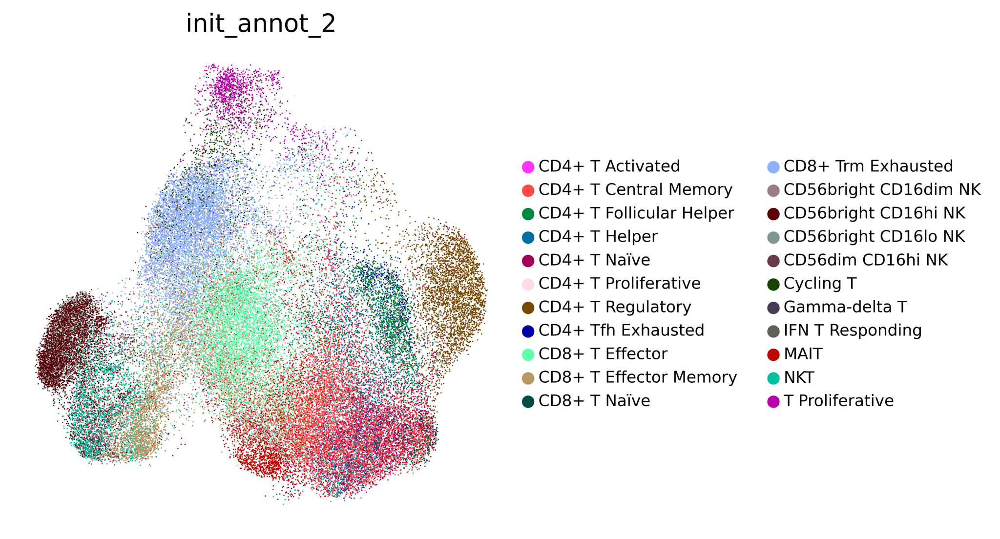

In [58]:
keep = adata.obs.init_annot_2.value_counts().index[adata.obs.init_annot_2.value_counts() >= 100].to_list()

sc.settings.set_figure_params(dpi=300, dpi_save=500, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata[adata.obs.init_annot_2.isin(keep)], 
    color=['init_annot_2'],
    frameon=False, 
    #legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    ncols=1,
    #save='_annot1_previous_QC.pdf'
)

In [6]:
adata.obs[adata.obs.leiden == "11"].init_annot_2.value_counts()

init_annot_2
CD4+ T Central Memory       897
CD4+ T Helper               845
CD4+ T Naïve                752
CD8+ Trm Exhausted          112
MAIT                        104
CD4+ T Follicular Helper    101
CD8+ T Effector Memory       77
CD8+ T Effector              39
IFN T Responding             29
CD4+ T Activated             26
Gamma-delta T                 7
CD4+ T Regulatory             6
Tumor                         6
CD4+ T Proliferative          6
CD8+ T Naïve                  2
NKT                           1
Cycling T                     1
B Cells                       1
Hepatocytes                   1
Plasma Cells                  0
Mast                          0
Proliferative                 0
T Proliferative               0
CD56bright CD16lo NK          0
Endothelial                   0
EMT-like                      0
CD56dim CD16hi NK             0
CAFs                          0
CD56bright CD16hi NK          0
CD56bright CD16dim NK         0
CD4+ Tfh Exhausted         

In [11]:
adata.obs.init_annot_2.isna()

barcode
AAACCTGAGGAACTGC-1-0     False
AAAGATGAGTACGACG-1-0     False
AACACGTGTACCAGTT-1-0     False
AACGTTGTCACCTTAT-1-0     False
AACTCCCTCCCAGGTG-1-0      True
                         ...  
TTTGTCATCACATACG-1-53     True
TTTGTCATCACGGTTA-1-53     True
TTTGTCATCCCTGACT-1-53     True
TTTGTCATCCGGGTGT-1-53     True
TTTGTCATCGCATGGC-1-53     True
Name: init_annot_2, Length: 173880, dtype: bool

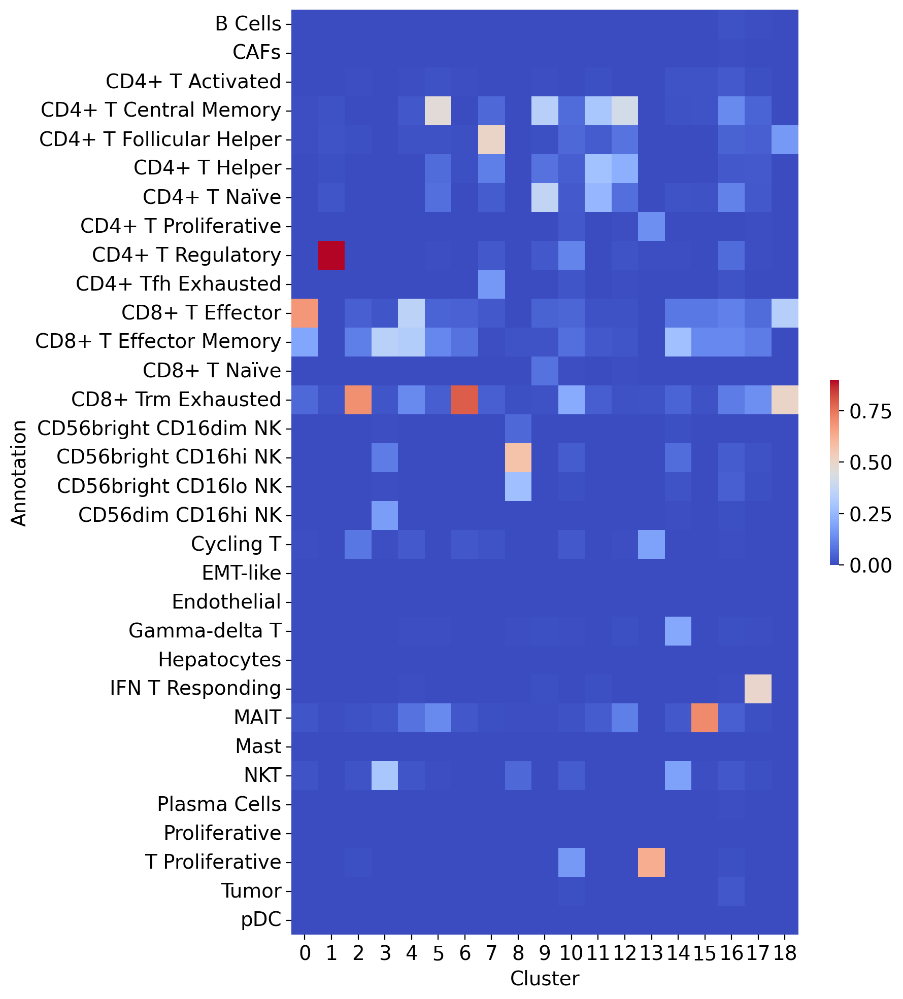

In [14]:
sc.settings.set_figure_params(dpi=100, dpi_save=500, figsize=(6,8), facecolor='white')

df = adata.obs[~adata.obs.init_annot_2.isna()]
sample_cluster_table = pd.crosstab(df['init_annot_2'], df['leiden_1.5'])
normalized_table = sample_cluster_table.div(sample_cluster_table.sum(axis=0), axis=1)
normalized_table.head()

# Plot the normalized table as a heatmap
plt.figure(figsize=(8, 12))
sns.heatmap(
    normalized_table, 
    annot=False, cmap="coolwarm", 
    cbar=True, fmt=".2f", cbar_kws={"shrink": 0.2}
)
plt.xlabel("Cluster")
plt.ylabel("Annotation")
plt.grid(None)
plt.show()